In [1]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"rnapark","key":"f766d3a80003b91cb04f4e4633ffd077"}'}

In [2]:
import os
os.makedirs('/root/.kaggle', exist_ok=True)
os.rename('kaggle.json', '/root/.kaggle/kaggle.json')

!chmod 600 /root/.kaggle/kaggle.json

!kaggle datasets list

ref                                                           title                                                     size  lastUpdated                 downloadCount  voteCount  usabilityRating  
------------------------------------------------------------  --------------------------------------------------  ----------  --------------------------  -------------  ---------  ---------------  
wardabilal/spotify-global-music-dataset-20092025              Spotify Global Music Dataset (2009–2025)               1289021  2025-11-11 09:43:05.933000          10748        243  1.0              
rohiteng/amazon-sales-dataset                                 Amazon Sales Dataset                                   4037578  2025-11-23 14:29:37.973000           3340         45  1.0              
khushikyad001/ai-impact-on-jobs-2030                          AI Impact on Jobs 2030                                   87410  2025-11-09 17:58:05.410000           6260        143  1.0              
mayabennet

In [3]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()

In [4]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

plant_pathology_2020_fgvc7_path = kagglehub.competition_download('plant-pathology-2020-fgvc7')
rnapark_resnet34_b627a593_pth_path = kagglehub.dataset_download('rnapark/resnet34-b627a593-pth')

print('Data source import complete.')


100%|██████████| 779M/779M [00:05<00:00, 152MB/s]

Extracting files...


100%|██████████| 77.2M/77.2M [00:00<00:00, 130MB/s]

Extracting files...


Data source import complete.


# Load data

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import torch
from torchvision import datasets, transforms
from torch.utils.data import Dataset, DataLoader, random_split
import matplotlib.pyplot as plt
from PIL import Image
import os

class AppleDataset(Dataset):
  def __init__(self, csv_path, images, transform=None, is_test=False):
    self.data = pd.read_csv(csv_path)
    self.images = images
    self.transform = transform
    self.is_test = is_test

  def __len__(self):
    return len(self.data)

  def __getitem__(self, idx):
    row = self.data.iloc[idx]
    image_path = os.path.join(self.images, row['image_id']+".jpg")
    image = Image.open(image_path).convert('RGB')
    if self.transform:
      image = self.transform(image)

    if self.is_test:
      return image
    else:
      label = row[['healthy', 'multiple_diseases', 'rust', 'scab']].values.astype("float32")
      return image, label


# Input data files are available in the read-only "../input/" directory

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [ ]:
# file paths
base_dir = plant_pathology_2020_fgvc7_path
train_csv = base_dir + "/train.csv"
test_csv  = base_dir + "/test.csv"
images = base_dir + "/images"

train_data = AppleDataset(train_csv, images, transform=None)
test_data  = AppleDataset(test_csv, images, transform=None, is_test=True)

## Helper to visualize training curves

In [ ]:
from matplotlib import pyplot as plt

# Helper function to visualize performance during training
def plot_training_curves(train_losses, val_accuracies):
    """Plot training loss and validation accuracy curves.

    Parameters
    ----------
    train_losses : list of float
        Training loss values for each epoch. Should have one value per epoch.
    val_accuracies : list of float
        Validation accuracy values for each epoch. Should have same length as
        train_losses. Accuracy values should be between 0 and 1 (or 0 and 100
        if using percentages).

    Returns
    -------
    None
        Displays matplotlib figure with two subplots showing training curves.

    Examples
    --------
    >>> train_losses = [0.8, 0.6, 0.4, 0.3, 0.2]
    >>> val_accuracies = [0.75, 0.80, 0.85, 0.87, 0.88]
    >>> plot_training_curves(train_losses, val_accuracies)
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    ax1.plot(train_losses)
    ax1.set_title('Training Loss')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.grid(True)

    ax2.plot(val_accuracies)
    ax2.set_title('Validation Accuracy')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

# Define training loop, evaluation loop

In [ ]:
# Define train/test loop

def mixup_data(x, y, alpha=0.2):
    # Returns mixed inputs, pairs of targets, and lambda.
    if alpha > 0:
        lam = np.random.beta(alpha, alpha)
    else:
        lam = 1

    batch_size = x.size()[0]
    index = torch.randperm(batch_size).to(x.device)

    mixed_x = lam * x + (1 - lam) * x[index, :]
    y_a, y_b = y, y[index]
    return mixed_x, y_a, y_b, lam

def train_loop(
        dataloader,
        model,
        loss_fn,
        optimizer,
        device,
        smoothing=0.02,
        grad_clip=1.0,
        use_mixup=True,
        mixup_alpha=0.2
    ):

    model.train()
    total_loss = 0.0

    for X, y in dataloader:
        X = X.to(device)
        y = y.float().to(device)
        y_smooth = y * (1 - smoothing) + (1 - y) * smoothing

        # MixUp augmentation
        if use_mixup:
            X, y_a, y_b, lam = mixup_data(X, y_smooth, alpha=mixup_alpha)

            # Apply label smoothing AFTER mixup
            y_a = y_a * (1 - smoothing) + (1 - y_a) * smoothing
            y_b = y_b * (1 - smoothing) + (1 - y_b) * smoothing

            pred = model(X)
            loss = lam * loss_fn(pred, y_a) + (1 - lam) * loss_fn(pred, y_b)
        else:
            # Only smoothing if NOT using mixup
            y_smooth = y * (1 - smoothing) + (1 - y) * smoothing
            pred = model(X)
            loss = loss_fn(pred, y_smooth)

        optimizer.zero_grad()
        loss.backward()

        # gradient clipping
        if grad_clip is not None:
            torch.nn.utils.clip_grad_norm_(model.parameters(), grad_clip)

        optimizer.step()

        total_loss += loss.item()

    return total_loss / len(dataloader)
def evaluate_model(dataloader, model, loss_fn, device):
    size = len(dataloader.dataset)
    num_batches = len(dataloader)
    test_loss, correct_predictions_sum = 0, 0
    num_labels = 4 # Number of output labels in our dataset

    model.eval()
    with torch.no_grad():
      for X, y in dataloader:
        X, y = X.to(device), y.to(device)
        pred = model(X) # These are logits
        test_loss += loss_fn(pred, y).item()

        # Apply sigmoid to logits to get probabilities
        probabilities = torch.sigmoid(pred)
        # Threshold probabilities to get binary predictions (0 or 1)
        predicted_labels = (probabilities > 0.5).float()
        # Count total correct individual label predictions (TP + TN)
        correct_predictions_sum += (predicted_labels == y).float().sum().item()

    test_loss = test_loss / num_batches
    # Calculate overall accuracy as the ratio of correctly predicted individual labels
    # to the total possible individual labels (num_samples * num_labels)
    total_possible_labels = size * num_labels
    accuracy = correct_predictions_sum / total_possible_labels
    return test_loss, accuracy

def predict_loop(loader, model, device):
    model.eval()
    all_labels = []
    all_probs = []

    with torch.no_grad():
        for images, labels in loader:
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            probs = torch.sigmoid(outputs)  # Raw probabilities for each class

            all_labels.append(labels.cpu())
            all_probs.append(probs.cpu())

    return torch.cat(all_labels, dim=0), torch.cat(all_probs, dim=0)

def predict_test_loop(loader, model, device):
    model.eval()
    all_probs = []

    with torch.no_grad():
        for batch in loader:
            if isinstance(batch, (list, tuple)):
                images = batch[0]
            else:
                images = batch

            images = images.to(device)

            outputs = model(images)
            probs = torch.sigmoid(outputs)  # Raw probabilities

            all_probs.append(probs.cpu())

    return torch.cat(all_probs, dim=0)


# Improving model with fine tuning

In [ ]:
def apply_thresholding(probs, thresholds):
    """
    Apply thresholds to the predicted probabilities.
    Args:
    - probs: The predicted probabilities for each class (shape: [batch_size, num_classes])
    - thresholds: The threshold value for each class (shape: [num_classes])

    Returns:
    - preds: The predicted class labels after applying thresholds (shape: [batch_size, num_classes])
    """
    # Initialize an array to store the predictions for each sample
    preds = torch.zeros_like(probs, dtype=torch.long)

    for i in range(probs.shape[0]):  # Iterate over each sample in the batch
        for c in range(probs.shape[1]):  # Iterate over each class
            if probs[i, c] > thresholds[c]:  # Check if the probability exceeds the threshold
                preds[i, c] = 1  # Set the class prediction to 1 (indicating the class is selected)

    # For each sample, choose the class with the maximum probability if no class exceeds threshold
    preds = torch.argmax(probs, dim=1)  # Use the highest probability class if no threshold is surpassed

    return preds

## Defining visualizations for evaluation

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score, precision_recall_curve, roc_curve, roc_auc_score, precision_recall_fscore_support

def plot_confusion_matrix(y_true, y_pred, class_names):
    # Generate a confusion matrix for each class in a one-vs-rest manner
    for i, class_name in enumerate(class_names):
        # For each class, consider it as positive and all others as negative
        true_labels = y_true[:, i]
        pred_labels = y_pred[:, i]
        cm = confusion_matrix(true_labels, pred_labels)

        # Extract metrics
        tn, fp, fn, tp = cm.ravel() if cm.size == 4 else (0, 0, 0, 0) # Handle cases where a class might not be present
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0

        print(f"\nMetrics for class: {class_name}")
        print(f"  True Positives (TP): {tp}")
        print(f"  False Positives (FP): {fp}")
        print(f"  False Negatives (FN): {fn}")
        print(f"  True Negatives (TN): {tn}")
        print(f"  Precision: {precision:.4f}")
        print(f"  Recall: {recall:.4f}")

        # Calculate and print F1-score
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) != 0 else 0
        print(f"  F1-score: {f1_score:.4f}")

        plt.figure(figsize=(6, 4))
        sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                    xticklabels=[f'Not {class_name}', class_name],
                    yticklabels=[f'Not {class_name}', class_name])
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title(f'Confusion Matrix for {class_name}')
        plt.show()

def plot_precision_recall_curve(y_true, y_pred, class_names):
    plt.figure(figsize=(10, 8))
    for i in range(len(class_names)):
        precision, recall, _ = precision_recall_curve(y_true[:, i], y_pred[:, i])
        plt.plot(recall, precision, label=f'{class_names[i]}')

    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc='best')
    plt.show()

def plot_roc_curve(y_true, y_pred, class_names):
    plt.figure(figsize=(10, 8))
    for i in range(len(class_names)):
        fpr, tpr, _ = roc_curve(y_true[:, i], y_pred[:, i])
        auc = roc_auc_score(y_true[:, i], y_pred[:, i])
        plt.plot(fpr, tpr, label=f'{class_names[i]} (AUC = {auc:.2f})')

    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc='best')
    plt.show()


def show_failure_cases(indices, val_subset, y_pred, y_probs_np, num=12):
    num = min(num, len(indices))
    plt.figure(figsize=(12, 12))

    for i, idx in enumerate(indices[:num]):
        img, label = val_subset[idx]        # this gives image + true label
        img_np = img.permute(1, 2, 0).numpy()
        img_np = img_np * np.array([0.229,0.224,0.225]) + np.array([0.485,0.456,0.406])
        img_np = np.clip(img_np, 0, 1)

        pred = y_pred[idx]
        prob = y_probs_np[idx]

        plt.subplot(4, 3, i+1)
        plt.imshow(img_np)
        plt.title(
            f"True: {label.tolist()}\nPred: {pred.tolist()}\nProb: {prob.round(2)}"
        )
        plt.axis("off")

    plt.tight_layout()
    plt.show()

def show_correct_confident_predictions(y_true, y_pred, y_probs_np, val_subset, num=12):
    """
    Display correctly classified samples with high confidence.

    Parameters
    ----------
    y_true : np.ndarray
        True labels.
    y_pred : np.ndarray
        Predicted labels (binary after thresholding).
    y_probs_np : np.ndarray
        Predicted probabilities.
    val_subset : torch.utils.data.Subset
        The validation dataset subset.
    num : int, optional
        Number of images to display. The default is 12.
    """
    # Identify samples where all labels were predicted correctly
    correctly_classified_mask = (y_pred == y_true).all(axis=1)
    correct_indices = np.where(correctly_classified_mask)[0]

    if len(correct_indices) == 0:
        print("No correctly classified samples found.")
        return

    # Get confidences for correctly classified samples
    # Using the max probability across the classes as a confidence measure
    correct_confidences = y_probs_np[correct_indices].max(axis=1)

    # Sort correctly classified samples by confidence, descending
    sorted_correct_indices = correct_indices[np.argsort(-correct_confidences)]

    num = min(num, len(sorted_correct_indices))
    plt.figure(figsize=(12, 12))

    for i, idx in enumerate(sorted_correct_indices[:num]):
        img, label = val_subset[idx]        # this gives image + true label
        img_np = img.permute(1, 2, 0).numpy()
        img_np = img_np * np.array([0.229,0.224,0.225]) + np.array([0.485,0.456,0.406])
        img_np = np.clip(img_np, 0, 1)

        pred = y_pred[idx]
        prob = y_probs_np[idx]

        plt.subplot(4, 3, i+1)
        plt.imshow(img_np)
        plt.title(
            f"True: {label.tolist()}\nPred: {pred.tolist()}\nProb: {prob.round(2)}"
        )
        plt.axis("off")

    plt.tight_layout()
    plt.show()


Training fold 1...
Epoch 1/15 - Fold 1
Training Loss: 1.1347, Validation Loss: 0.9880, Validation Accuracy: 0.5014
Epoch 2/15 - Fold 1
Training Loss: 1.0465, Validation Loss: 0.8989, Validation Accuracy: 0.6130
Epoch 3/15 - Fold 1
Training Loss: 0.9513, Validation Loss: 0.7673, Validation Accuracy: 0.6760
Epoch 4/15 - Fold 1
Training Loss: 0.8843, Validation Loss: 0.6622, Validation Accuracy: 0.7055
Epoch 5/15 - Fold 1
Training Loss: 0.8326, Validation Loss: 0.5683, Validation Accuracy: 0.7555
Epoch 6/15 - Fold 1
Training Loss: 0.7437, Validation Loss: 0.4912, Validation Accuracy: 0.8253
Epoch 7/15 - Fold 1
Training Loss: 0.7562, Validation Loss: 0.4384, Validation Accuracy: 0.8726
Epoch 8/15 - Fold 1
Training Loss: 0.6964, Validation Loss: 0.4128, Validation Accuracy: 0.8726
Epoch 9/15 - Fold 1
Training Loss: 0.6851, Validation Loss: 0.3945, Validation Accuracy: 0.8973
Epoch 10/15 - Fold 1
Training Loss: 0.6809, Validation Loss: 0.3740, Validation Accuracy: 0.8973
Epoch 11/15 - Fold 

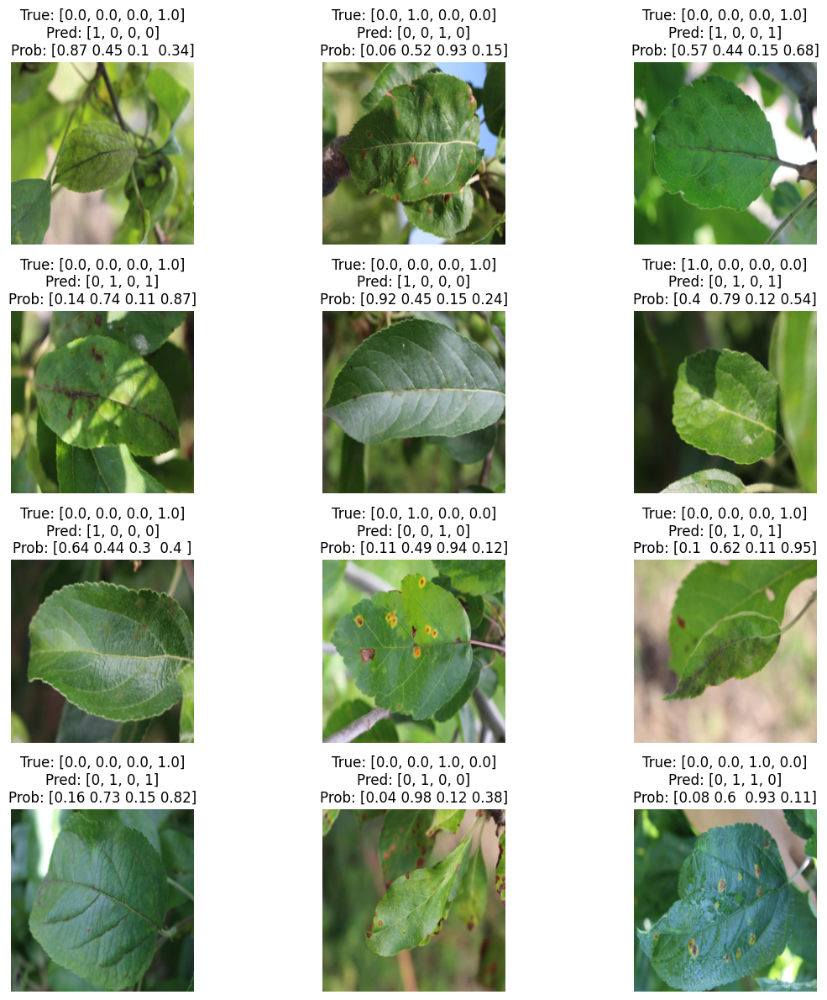


Showing high-confidence wrong predictions:


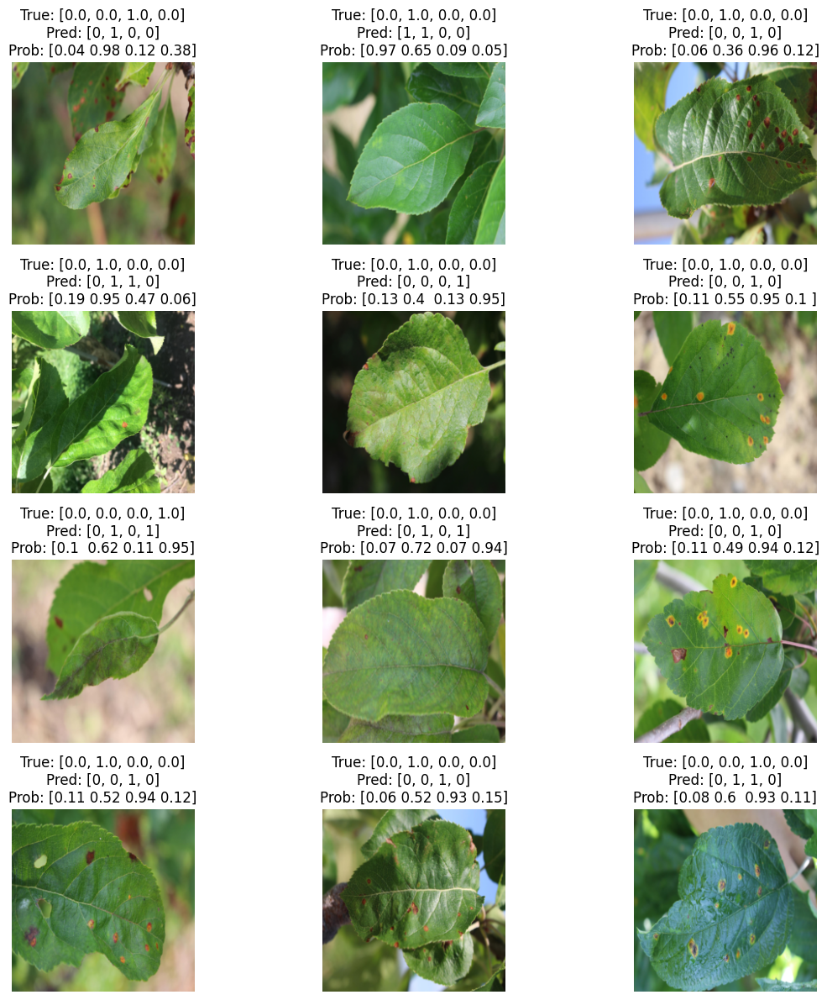


Showing correct and confident predictions:


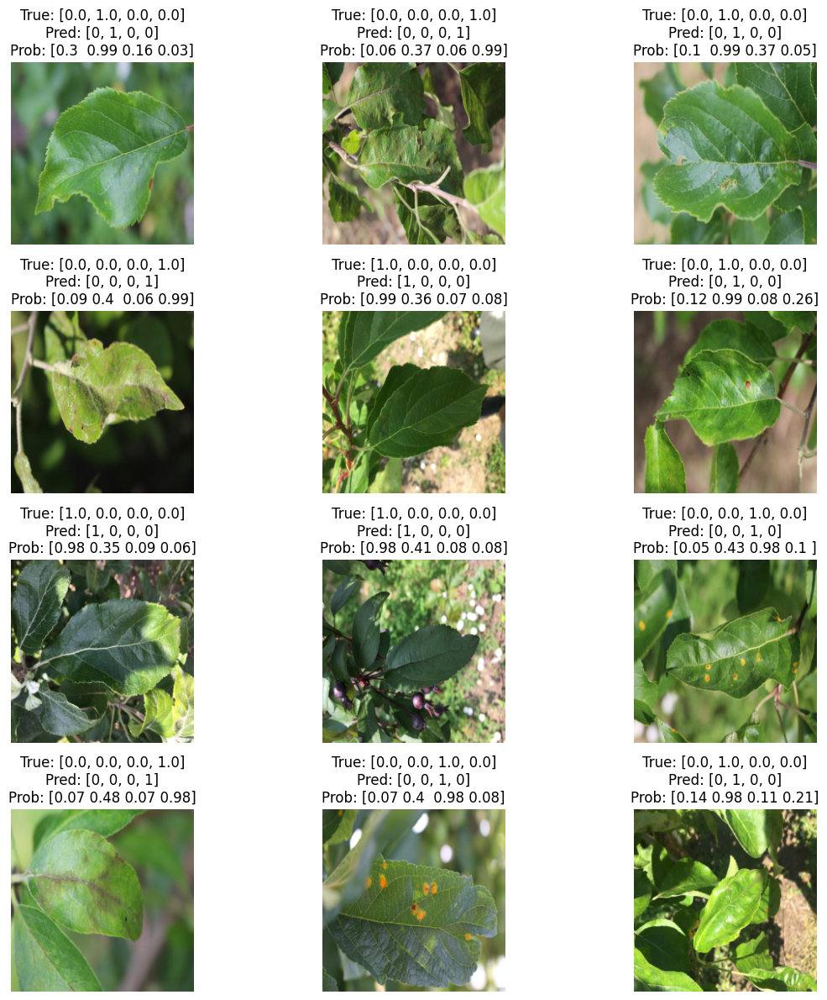


Metrics for class: healthy
  True Positives (TP): 102
  False Positives (FP): 8
  False Negatives (FN): 1
  True Negatives (TN): 254
  Precision: 0.9273
  Recall: 0.9903
  F1-score: 0.9577


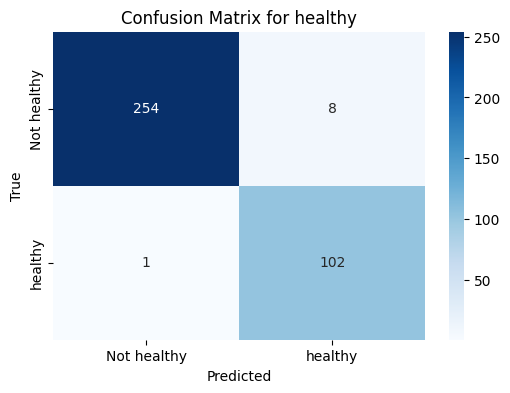


Metrics for class: multiple_diseases
  True Positives (TP): 11
  False Positives (FP): 15
  False Negatives (FN): 7
  True Negatives (TN): 332
  Precision: 0.4231
  Recall: 0.6111
  F1-score: 0.5000


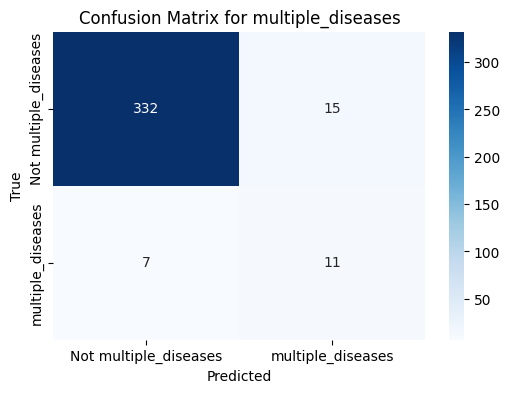


Metrics for class: rust
  True Positives (TP): 123
  False Positives (FP): 10
  False Negatives (FN): 2
  True Negatives (TN): 230
  Precision: 0.9248
  Recall: 0.9840
  F1-score: 0.9535


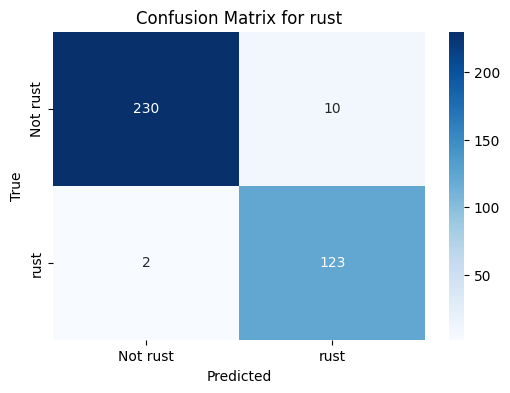


Metrics for class: scab
  True Positives (TP): 115
  False Positives (FP): 10
  False Negatives (FN): 4
  True Negatives (TN): 236
  Precision: 0.9200
  Recall: 0.9664
  F1-score: 0.9426


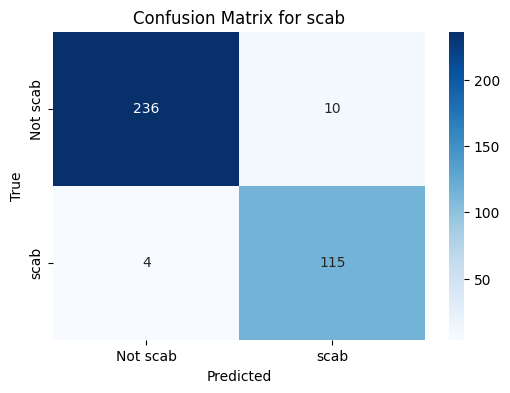

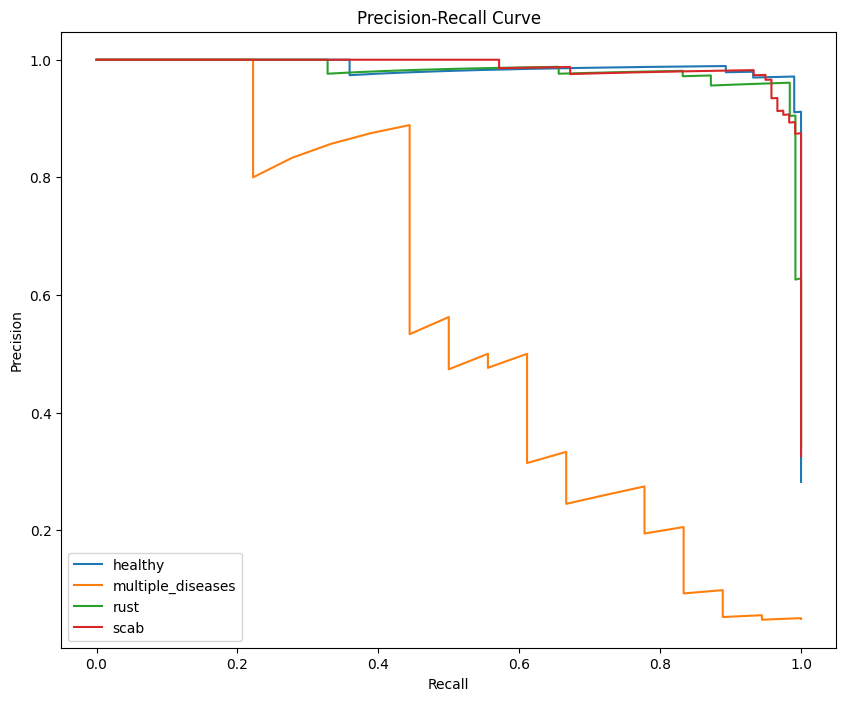

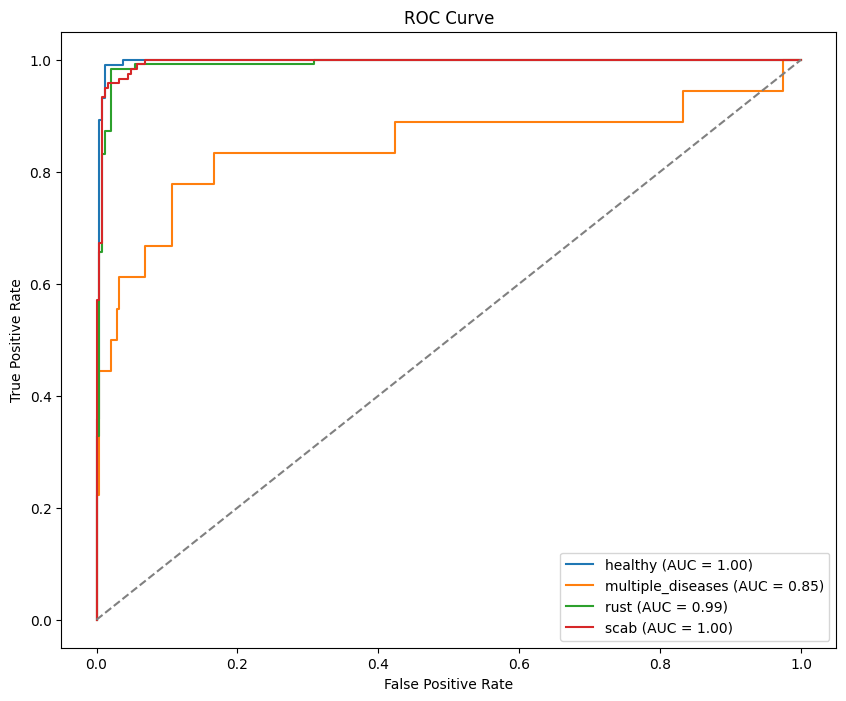


Training fold 2...
Epoch 1/15 - Fold 2
Training Loss: 1.1422, Validation Loss: 0.9730, Validation Accuracy: 0.4966
Epoch 2/15 - Fold 2
Training Loss: 1.0484, Validation Loss: 0.8936, Validation Accuracy: 0.6044
Epoch 3/15 - Fold 2
Training Loss: 0.9270, Validation Loss: 0.7391, Validation Accuracy: 0.6889
Epoch 4/15 - Fold 2
Training Loss: 0.8308, Validation Loss: 0.5905, Validation Accuracy: 0.7335
Epoch 5/15 - Fold 2
Training Loss: 0.8204, Validation Loss: 0.5295, Validation Accuracy: 0.7734
Epoch 6/15 - Fold 2
Training Loss: 0.7095, Validation Loss: 0.4704, Validation Accuracy: 0.8221
Epoch 7/15 - Fold 2
Training Loss: 0.7279, Validation Loss: 0.4352, Validation Accuracy: 0.8716
Epoch 8/15 - Fold 2
Training Loss: 0.6683, Validation Loss: 0.4111, Validation Accuracy: 0.8757
Epoch 9/15 - Fold 2
Training Loss: 0.6857, Validation Loss: 0.4012, Validation Accuracy: 0.8997
Epoch 10/15 - Fold 2
Training Loss: 0.6831, Validation Loss: 0.4173, Validation Accuracy: 0.8681
Epoch 11/15 - Fold 

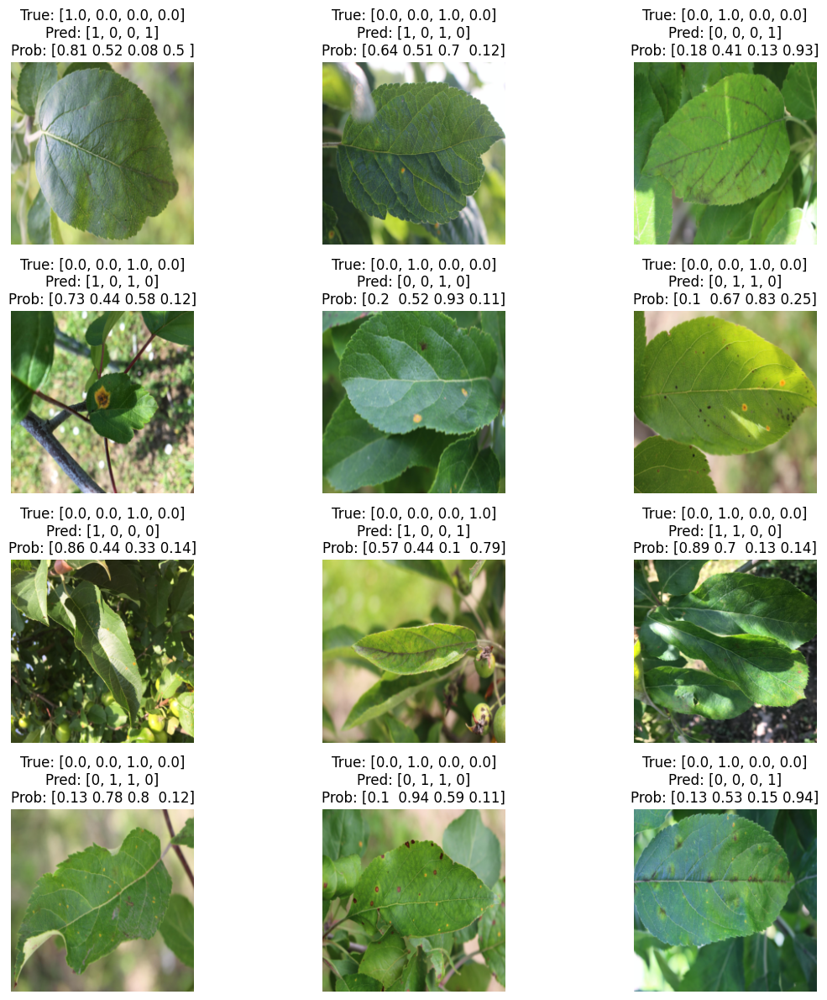


Showing high-confidence wrong predictions:


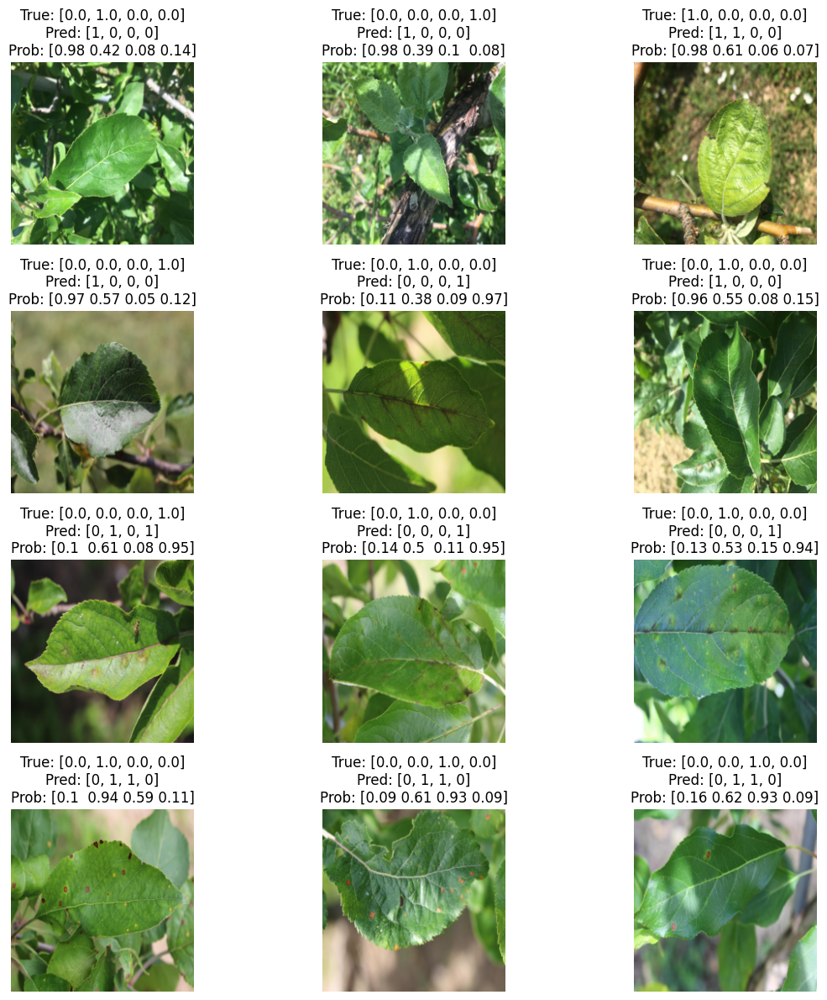


Showing correct and confident predictions:


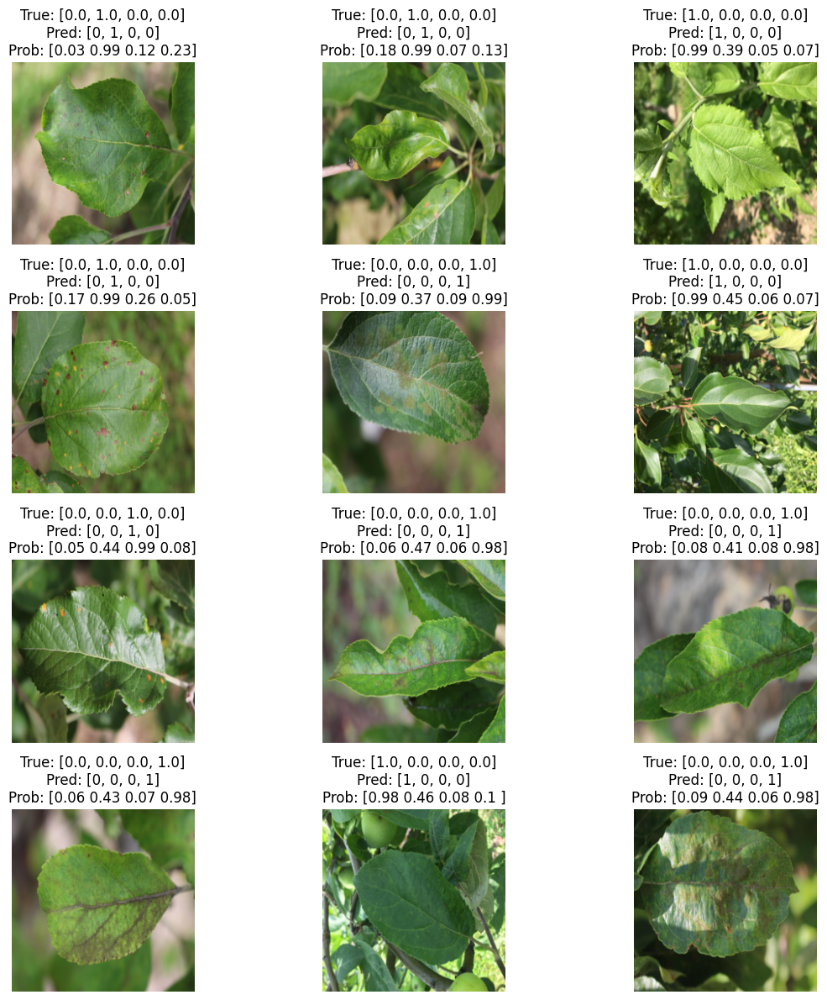


Metrics for class: healthy
  True Positives (TP): 103
  False Positives (FP): 16
  False Negatives (FN): 0
  True Negatives (TN): 245
  Precision: 0.8655
  Recall: 1.0000
  F1-score: 0.9279


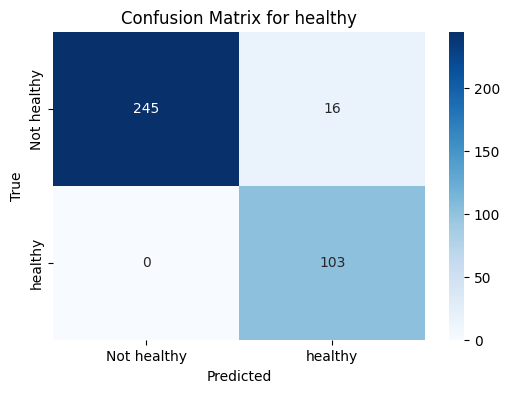


Metrics for class: multiple_diseases
  True Positives (TP): 10
  False Positives (FP): 15
  False Negatives (FN): 8
  True Negatives (TN): 331
  Precision: 0.4000
  Recall: 0.5556
  F1-score: 0.4651


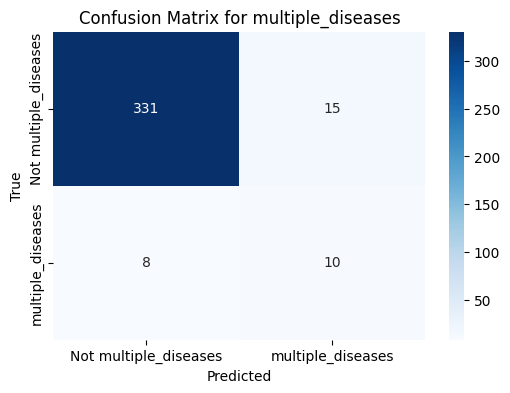


Metrics for class: rust
  True Positives (TP): 123
  False Positives (FP): 3
  False Negatives (FN): 1
  True Negatives (TN): 237
  Precision: 0.9762
  Recall: 0.9919
  F1-score: 0.9840


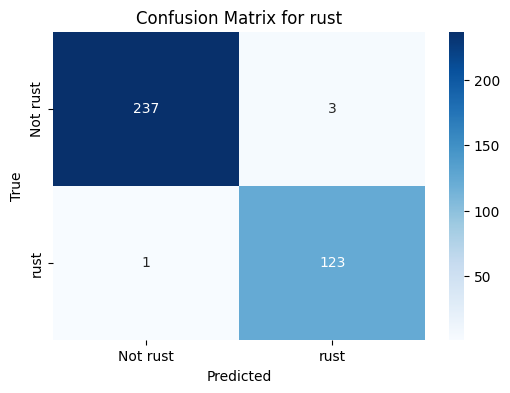


Metrics for class: scab
  True Positives (TP): 114
  False Positives (FP): 10
  False Negatives (FN): 5
  True Negatives (TN): 235
  Precision: 0.9194
  Recall: 0.9580
  F1-score: 0.9383


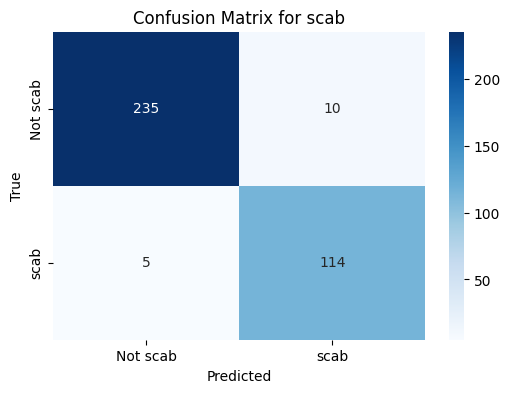

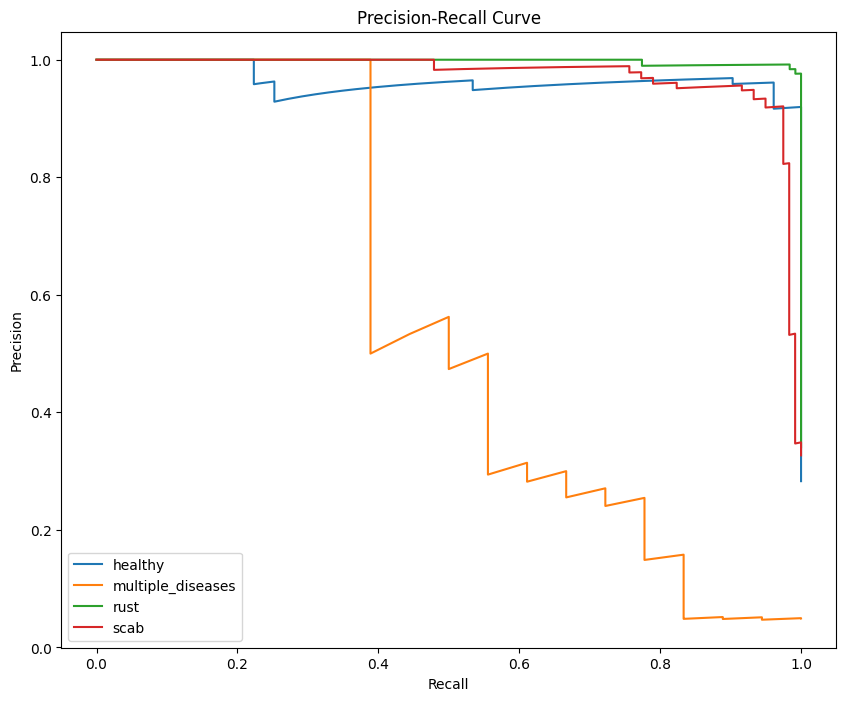

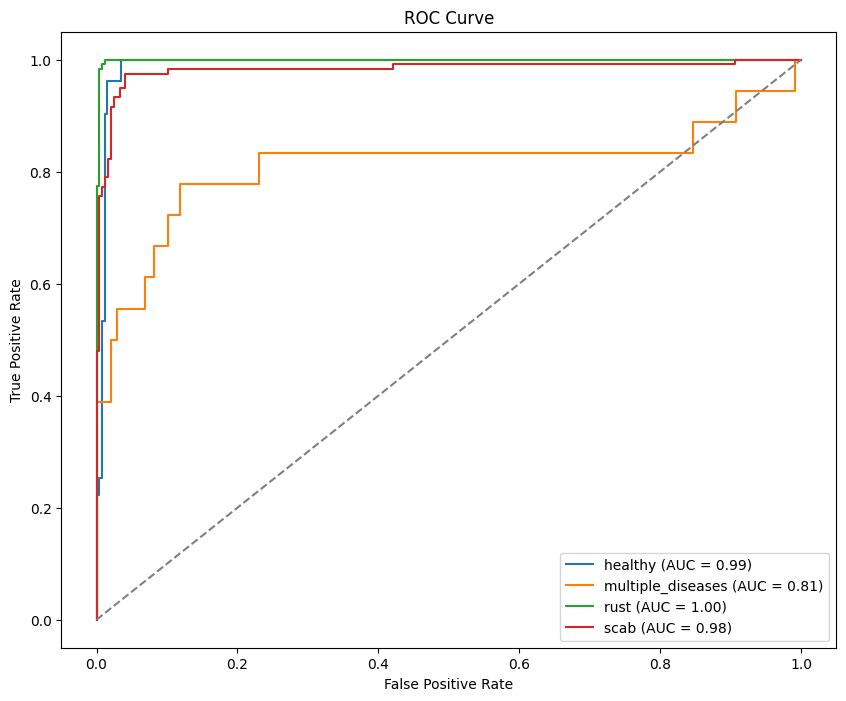


Training fold 3...
Epoch 1/15 - Fold 3
Training Loss: 1.1331, Validation Loss: 0.9675, Validation Accuracy: 0.4856
Epoch 2/15 - Fold 3
Training Loss: 1.0364, Validation Loss: 0.8747, Validation Accuracy: 0.6051
Epoch 3/15 - Fold 3
Training Loss: 0.9294, Validation Loss: 0.7508, Validation Accuracy: 0.6580
Epoch 4/15 - Fold 3
Training Loss: 0.8487, Validation Loss: 0.6397, Validation Accuracy: 0.7466
Epoch 5/15 - Fold 3
Training Loss: 0.8236, Validation Loss: 0.5778, Validation Accuracy: 0.7946
Epoch 6/15 - Fold 3
Training Loss: 0.7877, Validation Loss: 0.5238, Validation Accuracy: 0.8530
Epoch 7/15 - Fold 3
Training Loss: 0.6980, Validation Loss: 0.4802, Validation Accuracy: 0.8620
Epoch 8/15 - Fold 3
Training Loss: 0.6802, Validation Loss: 0.4399, Validation Accuracy: 0.8874
Epoch 9/15 - Fold 3
Training Loss: 0.6499, Validation Loss: 0.4071, Validation Accuracy: 0.8977
Epoch 10/15 - Fold 3
Training Loss: 0.7015, Validation Loss: 0.4121, Validation Accuracy: 0.8984
Epoch 11/15 - Fold 

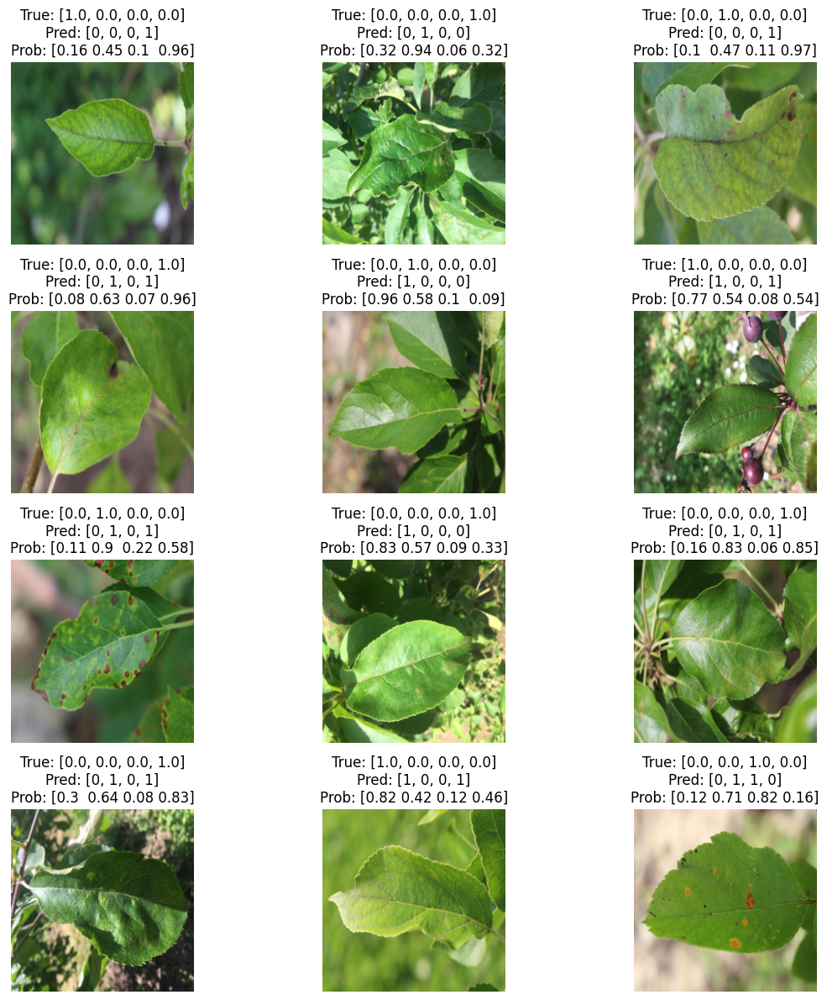


Showing high-confidence wrong predictions:


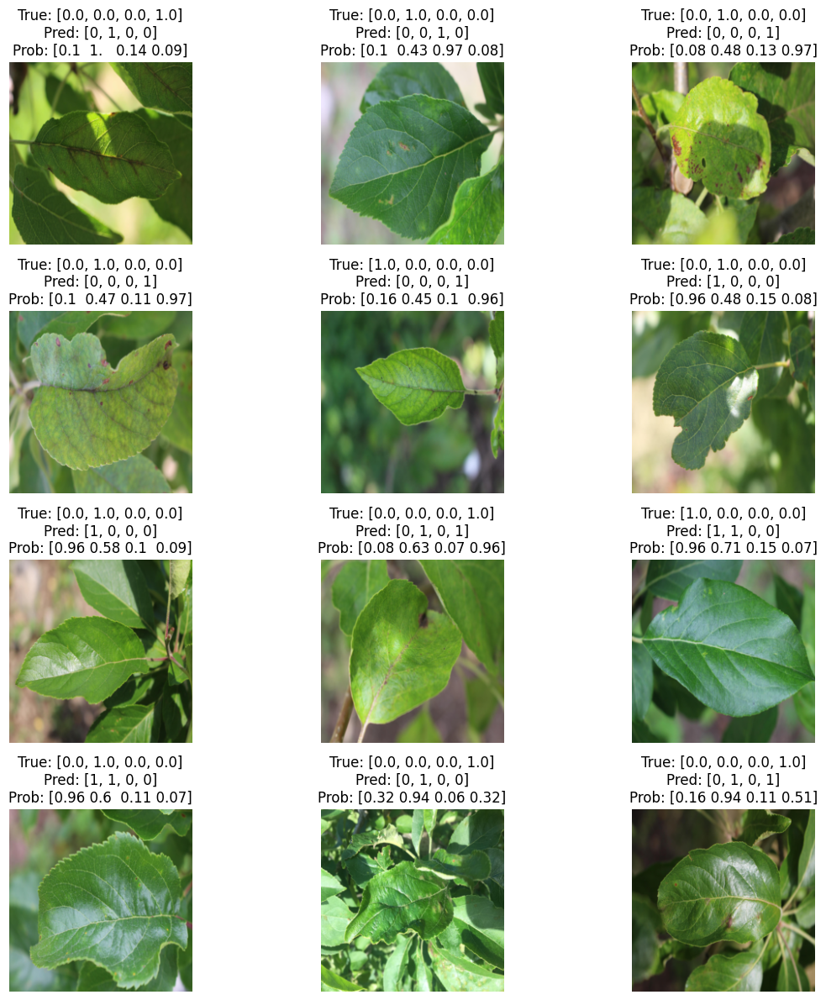


Showing correct and confident predictions:


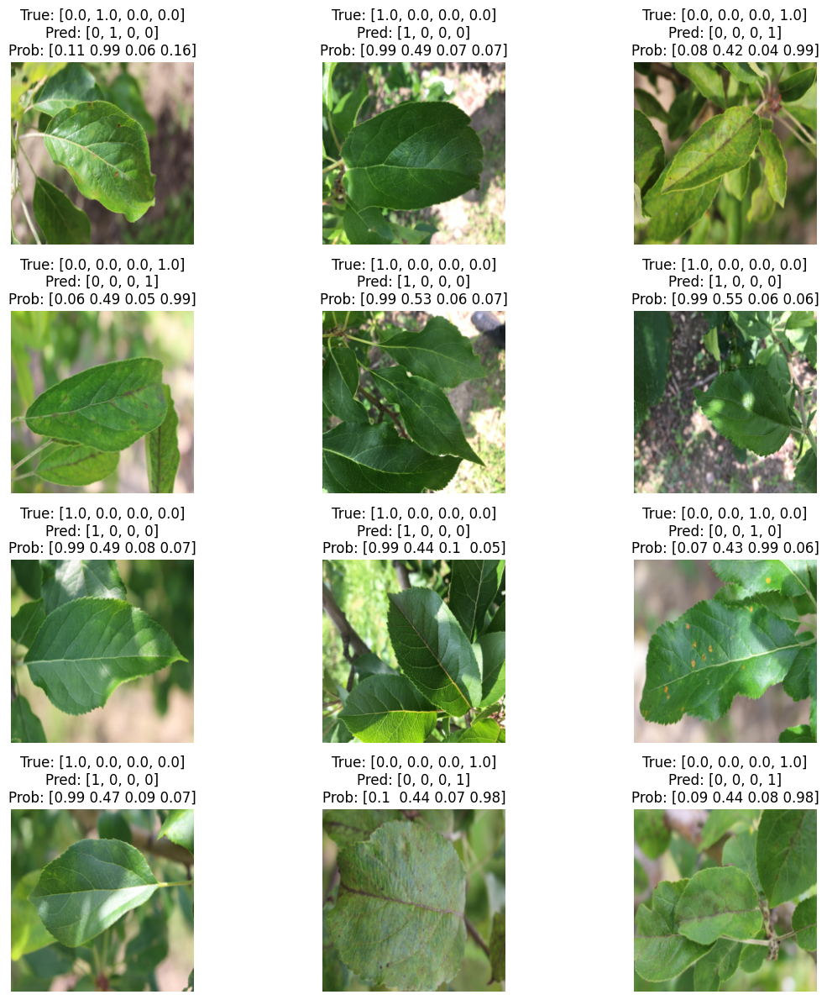


Metrics for class: healthy
  True Positives (TP): 102
  False Positives (FP): 9
  False Negatives (FN): 1
  True Negatives (TN): 252
  Precision: 0.9189
  Recall: 0.9903
  F1-score: 0.9533


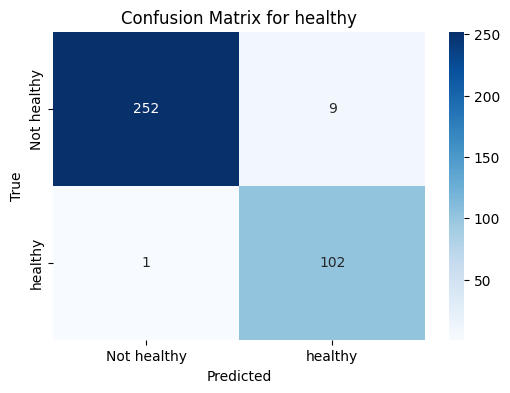


Metrics for class: multiple_diseases
  True Positives (TP): 11
  False Positives (FP): 21
  False Negatives (FN): 8
  True Negatives (TN): 324
  Precision: 0.3438
  Recall: 0.5789
  F1-score: 0.4314


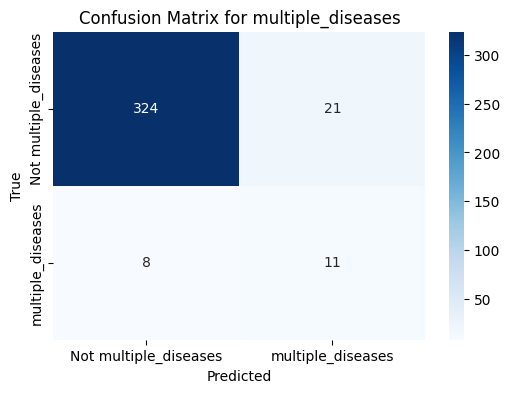


Metrics for class: rust
  True Positives (TP): 124
  False Positives (FP): 8
  False Negatives (FN): 0
  True Negatives (TN): 232
  Precision: 0.9394
  Recall: 1.0000
  F1-score: 0.9688


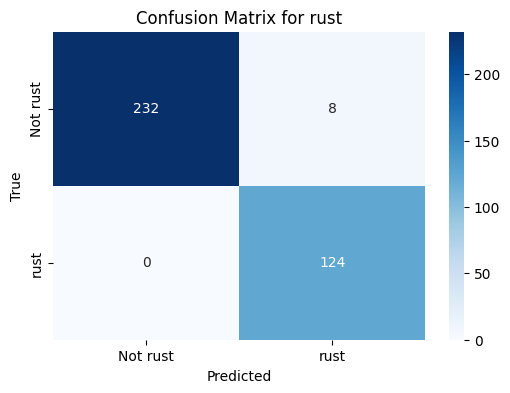


Metrics for class: scab
  True Positives (TP): 112
  False Positives (FP): 13
  False Negatives (FN): 6
  True Negatives (TN): 233
  Precision: 0.8960
  Recall: 0.9492
  F1-score: 0.9218


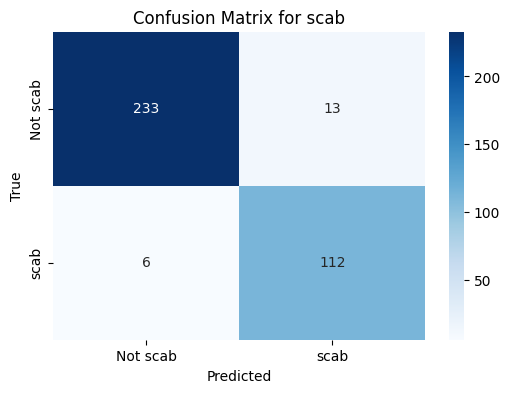

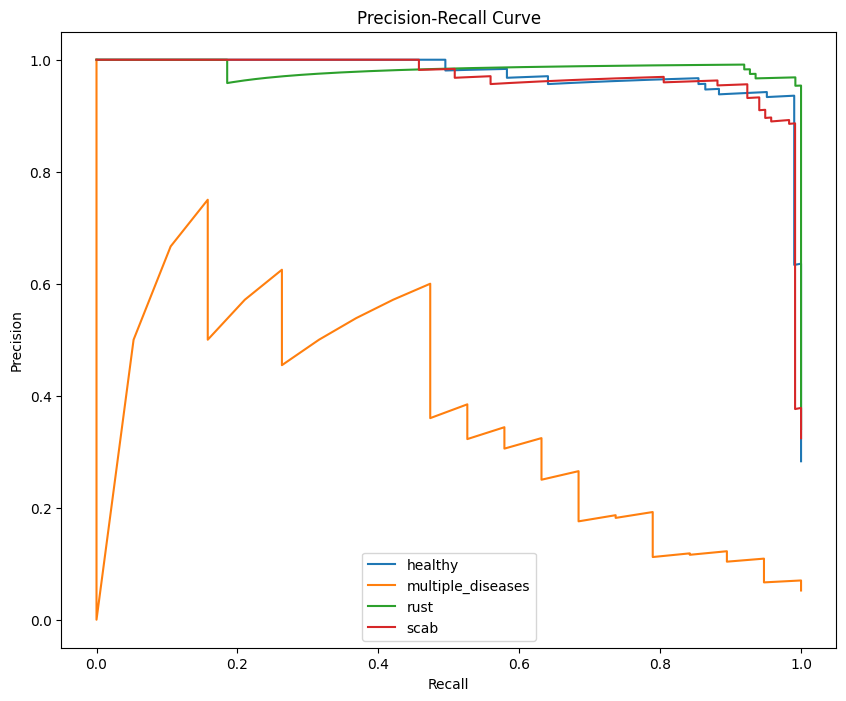

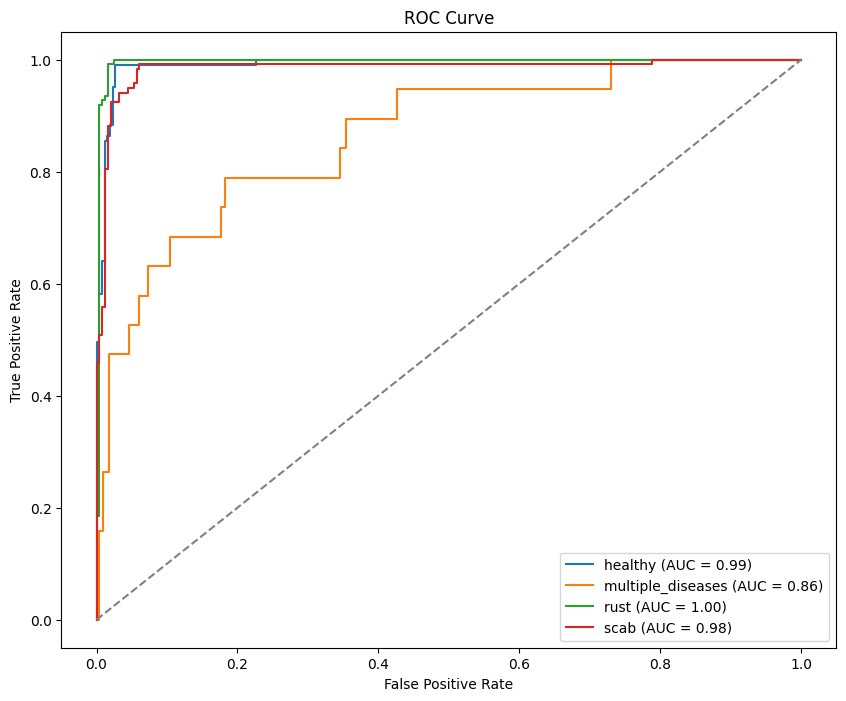


Training fold 4...
Epoch 1/15 - Fold 4
Training Loss: 1.1397, Validation Loss: 0.9826, Validation Accuracy: 0.4629
Epoch 2/15 - Fold 4
Training Loss: 1.0452, Validation Loss: 0.8990, Validation Accuracy: 0.6257
Epoch 3/15 - Fold 4
Training Loss: 0.9615, Validation Loss: 0.7621, Validation Accuracy: 0.6848
Epoch 4/15 - Fold 4
Training Loss: 0.8919, Validation Loss: 0.6472, Validation Accuracy: 0.7143
Epoch 5/15 - Fold 4
Training Loss: 0.8175, Validation Loss: 0.5559, Validation Accuracy: 0.7521
Epoch 6/15 - Fold 4
Training Loss: 0.7539, Validation Loss: 0.4774, Validation Accuracy: 0.8372
Epoch 7/15 - Fold 4
Training Loss: 0.6878, Validation Loss: 0.4163, Validation Accuracy: 0.8716
Epoch 8/15 - Fold 4
Training Loss: 0.7139, Validation Loss: 0.3956, Validation Accuracy: 0.8791
Epoch 9/15 - Fold 4
Training Loss: 0.7022, Validation Loss: 0.3897, Validation Accuracy: 0.9011
Epoch 10/15 - Fold 4
Training Loss: 0.7239, Validation Loss: 0.3983, Validation Accuracy: 0.8867
Epoch 11/15 - Fold 

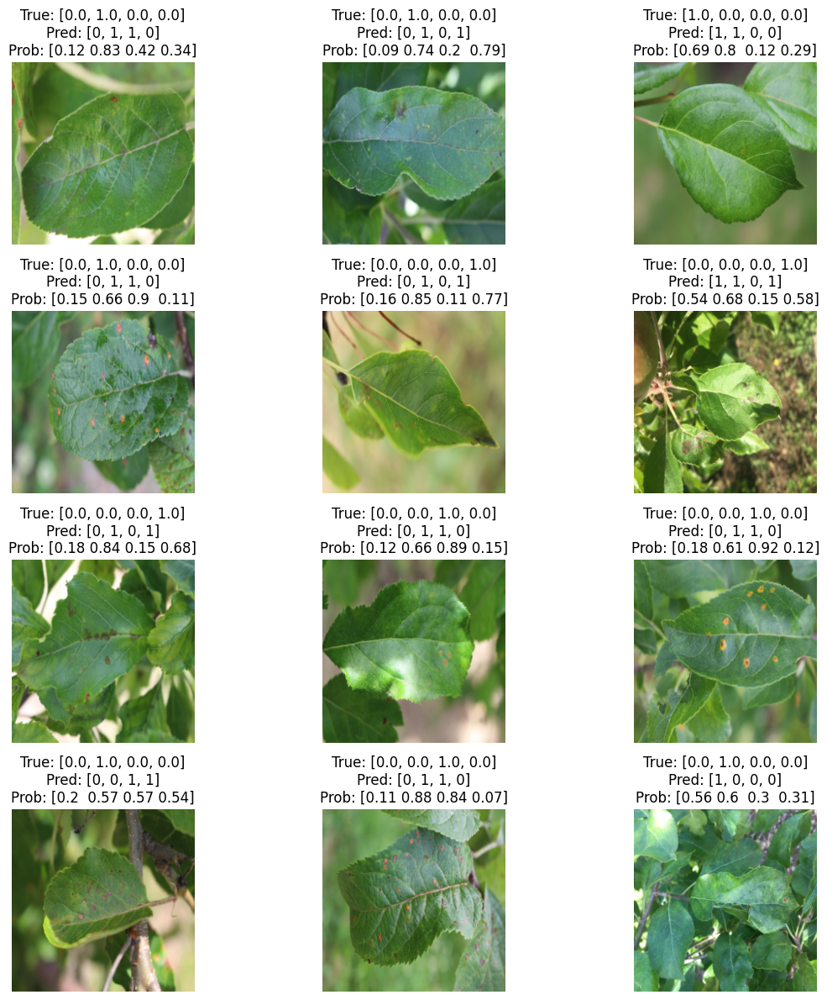


Showing high-confidence wrong predictions:


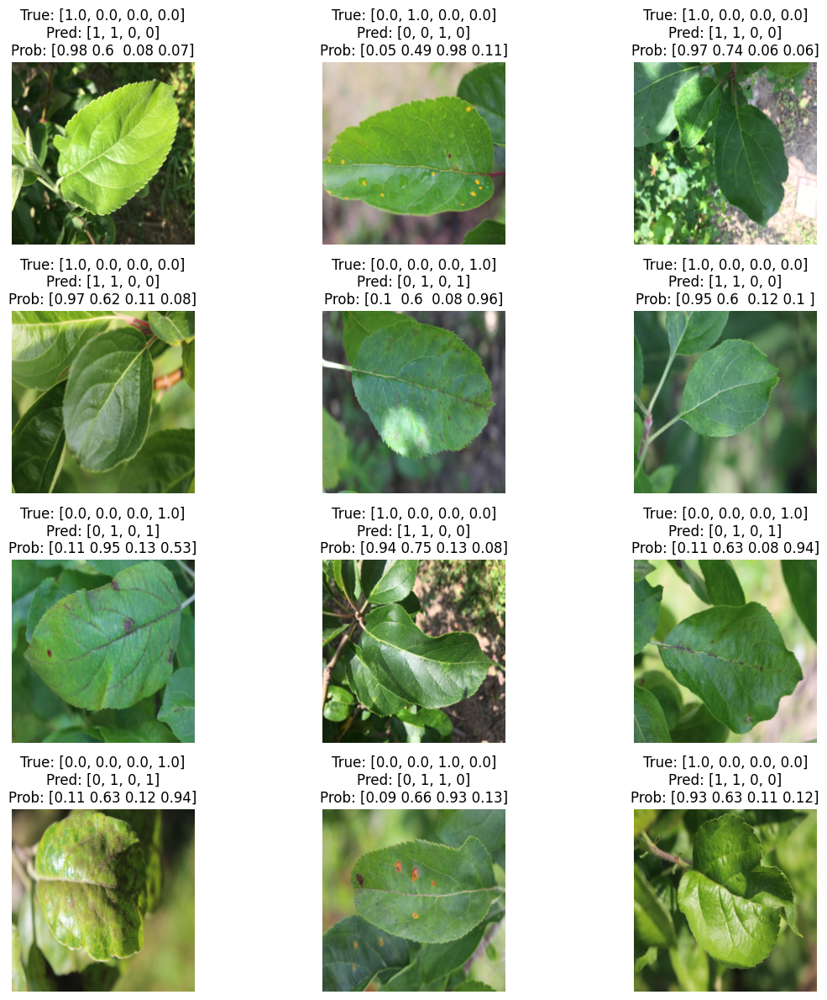


Showing correct and confident predictions:


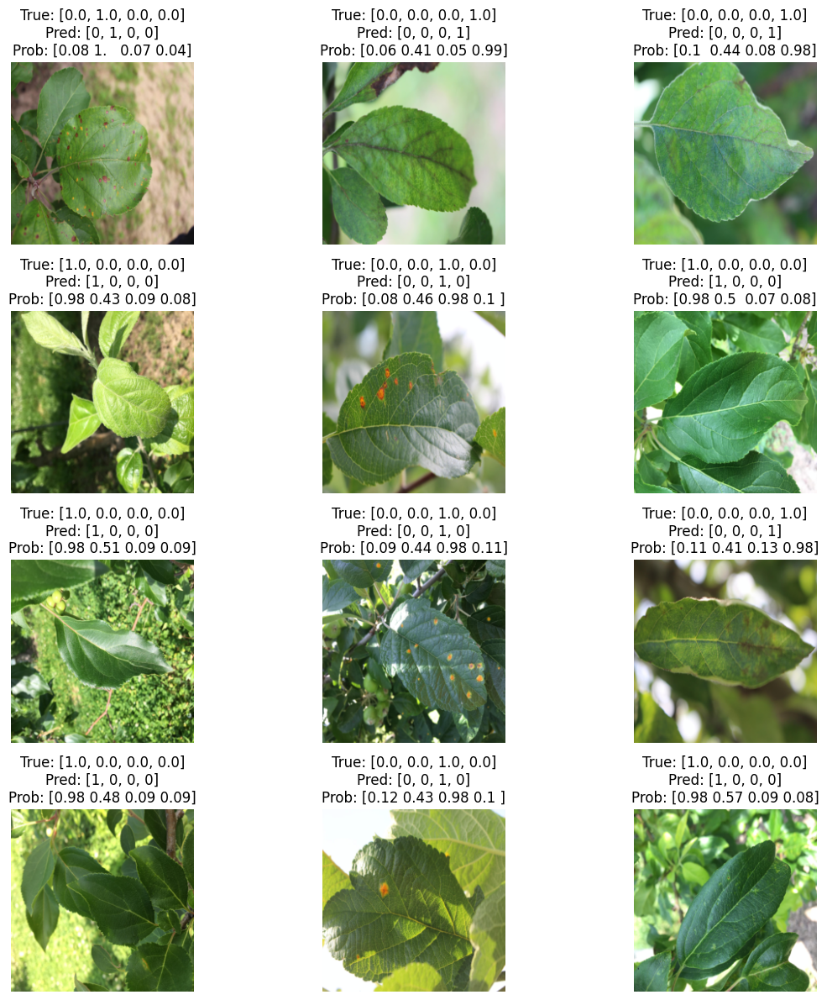


Metrics for class: healthy
  True Positives (TP): 103
  False Positives (FP): 5
  False Negatives (FN): 1
  True Negatives (TN): 255
  Precision: 0.9537
  Recall: 0.9904
  F1-score: 0.9717


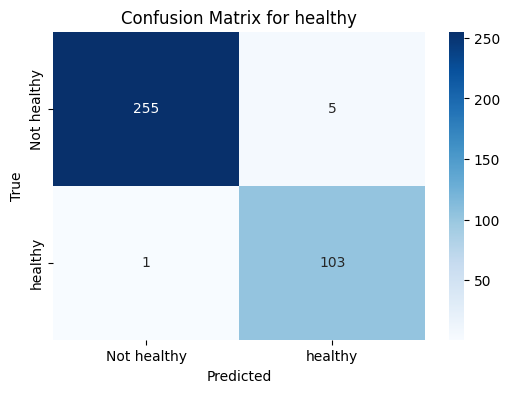


Metrics for class: multiple_diseases
  True Positives (TP): 13
  False Positives (FP): 56
  False Negatives (FN): 5
  True Negatives (TN): 290
  Precision: 0.1884
  Recall: 0.7222
  F1-score: 0.2989


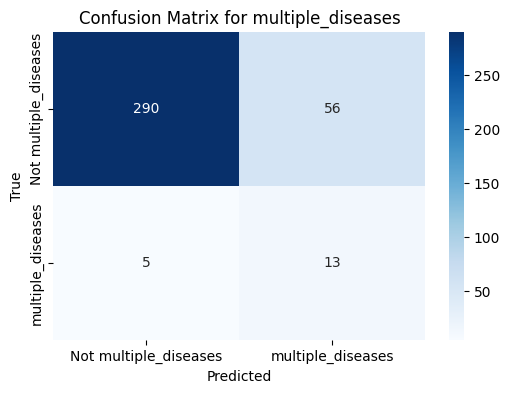


Metrics for class: rust
  True Positives (TP): 124
  False Positives (FP): 10
  False Negatives (FN): 0
  True Negatives (TN): 230
  Precision: 0.9254
  Recall: 1.0000
  F1-score: 0.9612


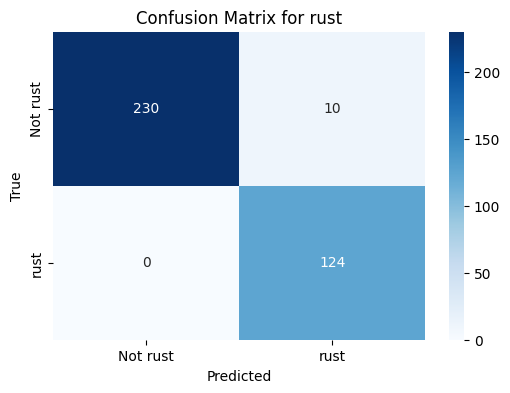


Metrics for class: scab
  True Positives (TP): 116
  False Positives (FP): 9
  False Negatives (FN): 2
  True Negatives (TN): 237
  Precision: 0.9280
  Recall: 0.9831
  F1-score: 0.9547


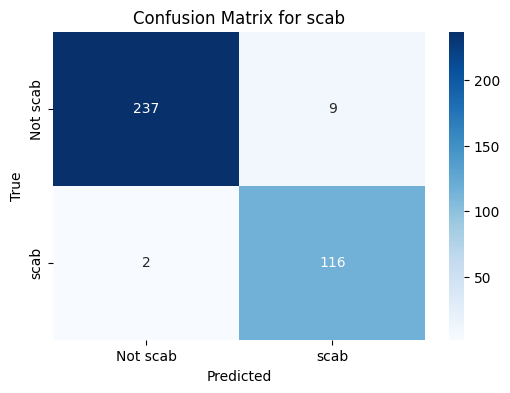

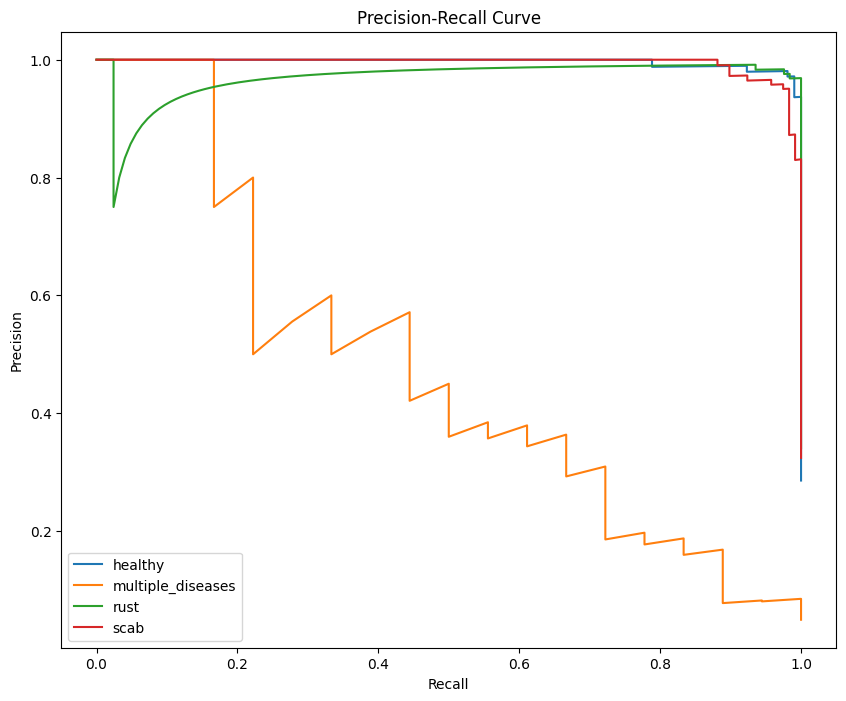

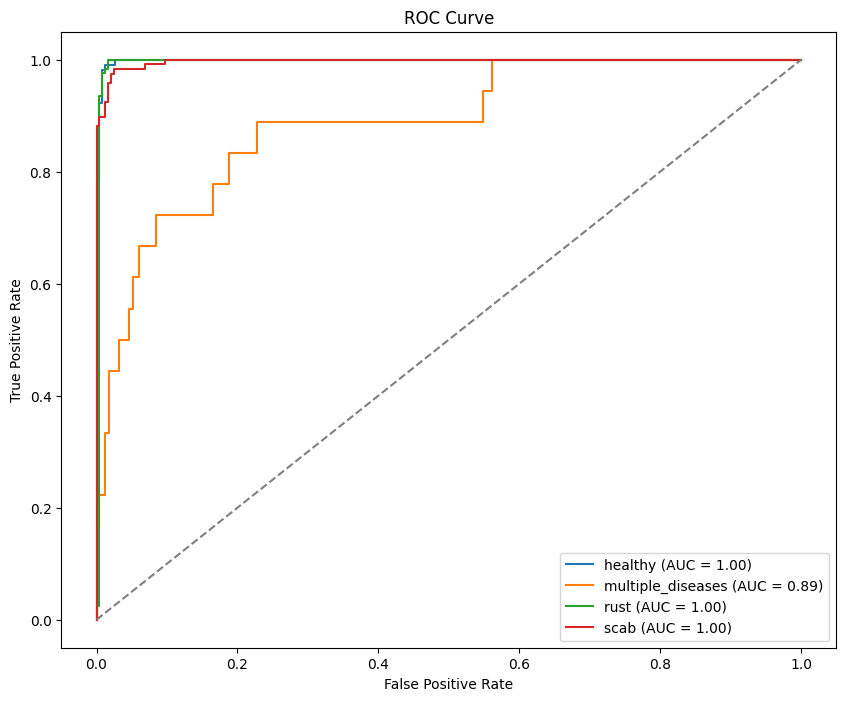


Training fold 5...
Epoch 1/15 - Fold 5
Training Loss: 1.1416, Validation Loss: 0.9828, Validation Accuracy: 0.5220
Epoch 2/15 - Fold 5
Training Loss: 1.0500, Validation Loss: 0.9022, Validation Accuracy: 0.6223
Epoch 3/15 - Fold 5
Training Loss: 0.9433, Validation Loss: 0.7625, Validation Accuracy: 0.6923
Epoch 4/15 - Fold 5
Training Loss: 0.8689, Validation Loss: 0.6510, Validation Accuracy: 0.7349
Epoch 5/15 - Fold 5
Training Loss: 0.7792, Validation Loss: 0.5548, Validation Accuracy: 0.7754
Epoch 6/15 - Fold 5
Training Loss: 0.7659, Validation Loss: 0.4995, Validation Accuracy: 0.8352
Epoch 7/15 - Fold 5
Training Loss: 0.7298, Validation Loss: 0.4567, Validation Accuracy: 0.8668
Epoch 8/15 - Fold 5
Training Loss: 0.6791, Validation Loss: 0.4158, Validation Accuracy: 0.8997
Epoch 9/15 - Fold 5
Training Loss: 0.7153, Validation Loss: 0.4330, Validation Accuracy: 0.9038
Epoch 10/15 - Fold 5
Training Loss: 0.6500, Validation Loss: 0.4190, Validation Accuracy: 0.8929
Epoch 11/15 - Fold 

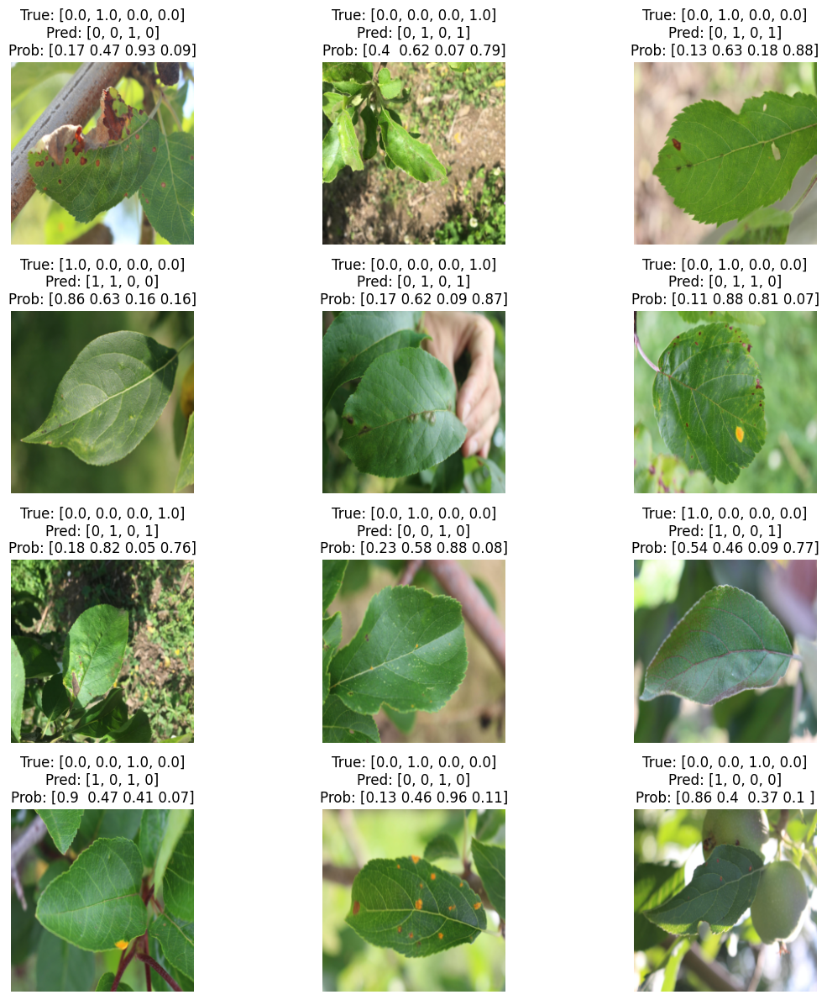


Showing high-confidence wrong predictions:


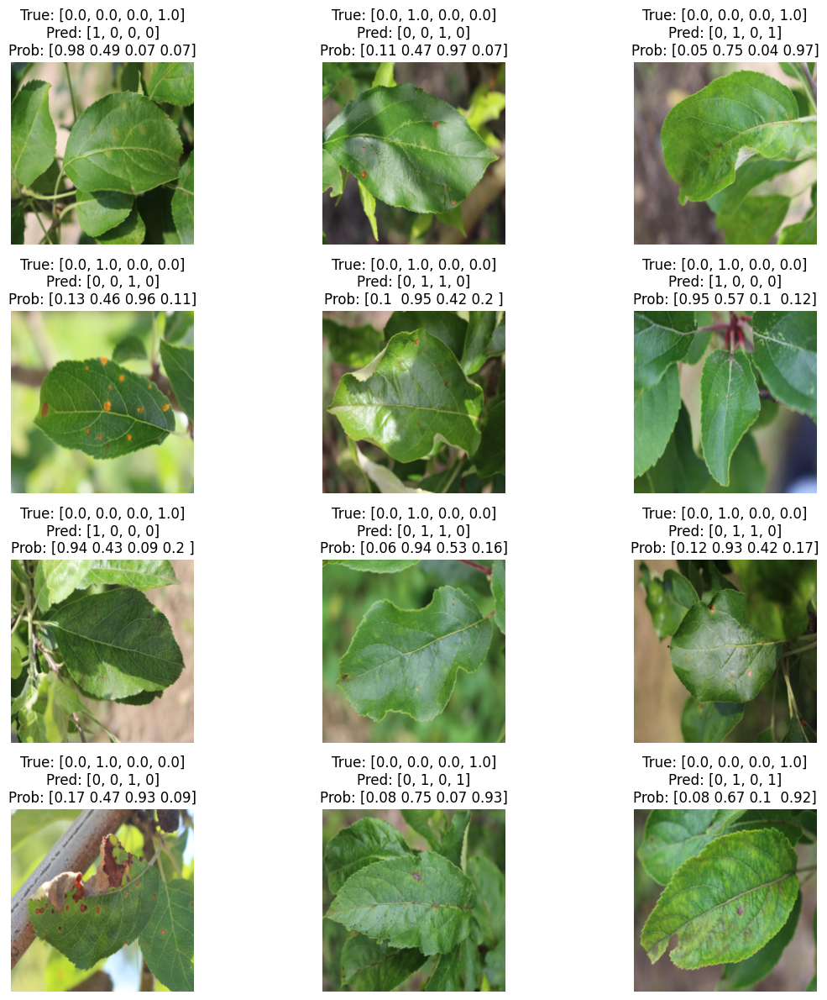


Showing correct and confident predictions:


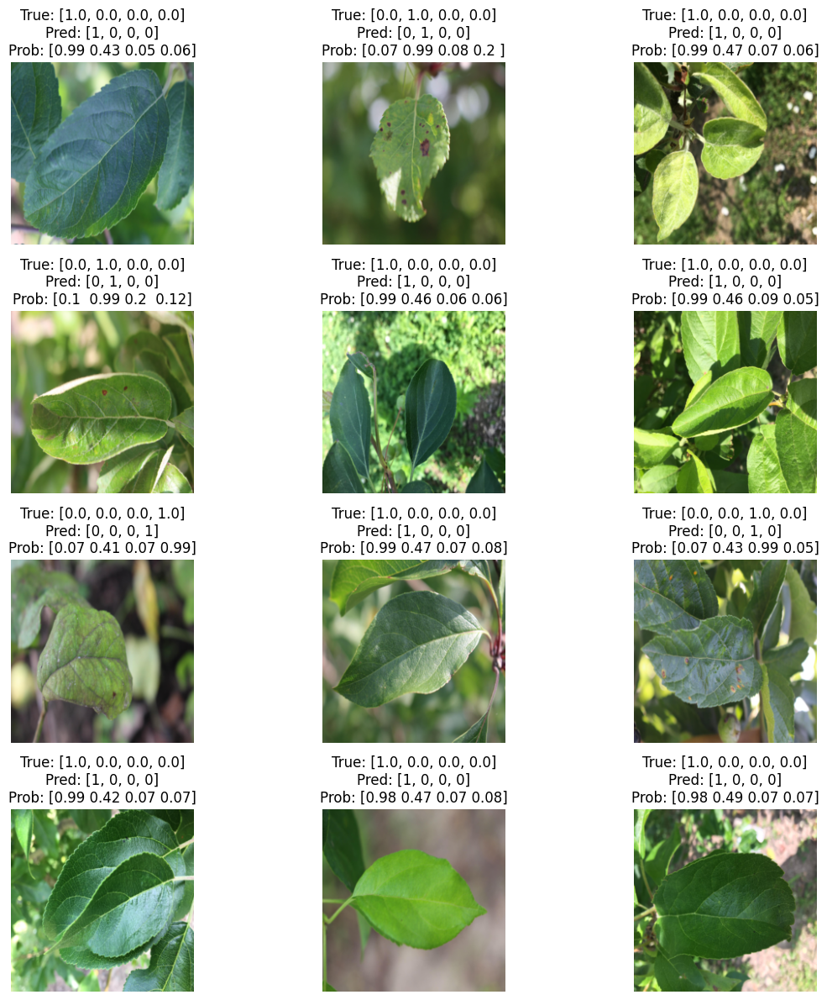


Metrics for class: healthy
  True Positives (TP): 103
  False Positives (FP): 19
  False Negatives (FN): 0
  True Negatives (TN): 242
  Precision: 0.8443
  Recall: 1.0000
  F1-score: 0.9156


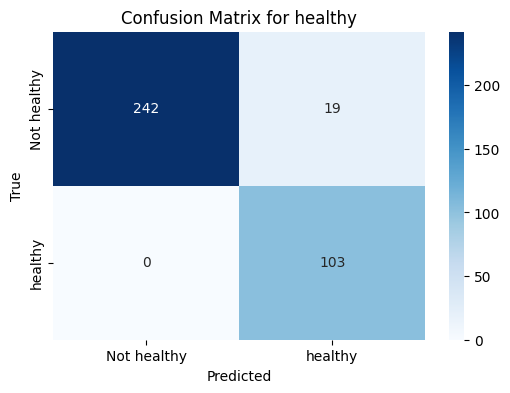


Metrics for class: multiple_diseases
  True Positives (TP): 13
  False Positives (FP): 16
  False Negatives (FN): 5
  True Negatives (TN): 330
  Precision: 0.4483
  Recall: 0.7222
  F1-score: 0.5532


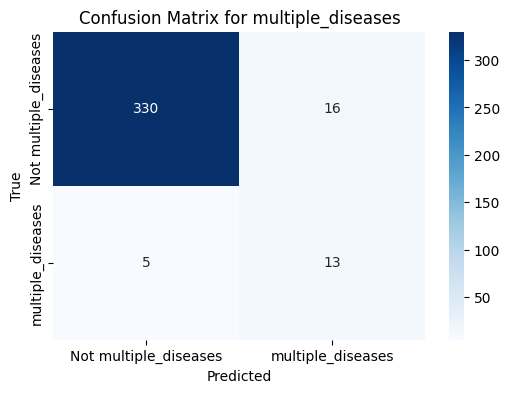


Metrics for class: rust
  True Positives (TP): 123
  False Positives (FP): 12
  False Negatives (FN): 2
  True Negatives (TN): 227
  Precision: 0.9111
  Recall: 0.9840
  F1-score: 0.9462


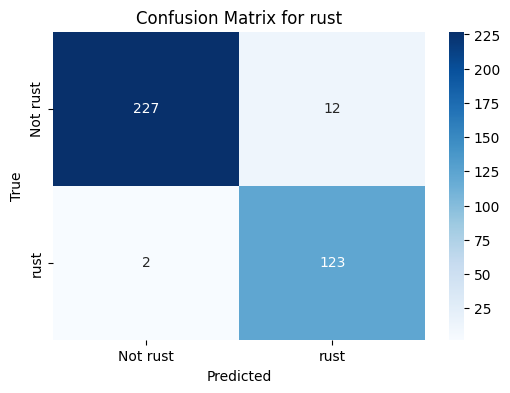


Metrics for class: scab
  True Positives (TP): 112
  False Positives (FP): 4
  False Negatives (FN): 6
  True Negatives (TN): 242
  Precision: 0.9655
  Recall: 0.9492
  F1-score: 0.9573


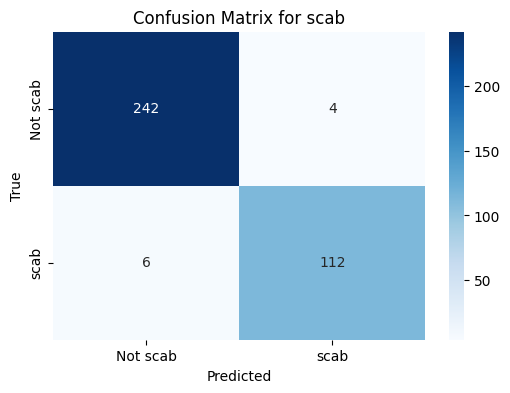

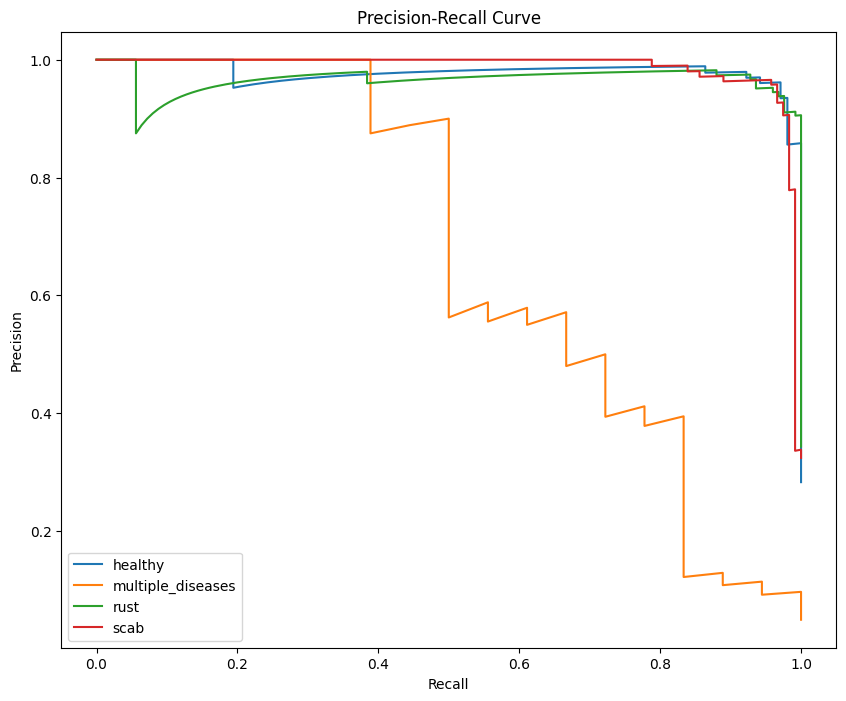

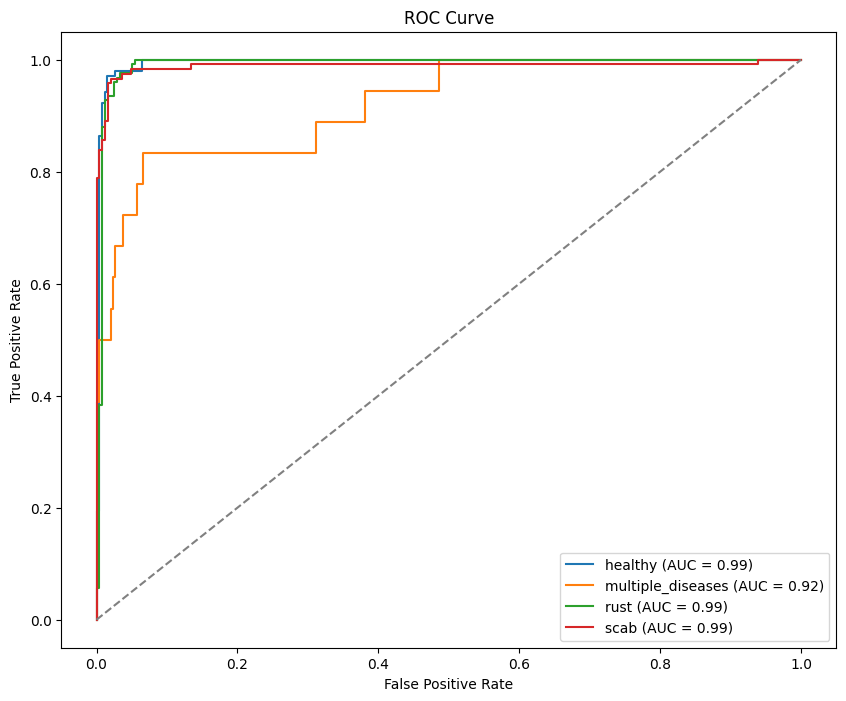

Kaggle submission file 'submission.csv' generated successfully!
  image_id   healthy  multiple_diseases      rust      scab
0   Test_0  0.110732           0.499780  0.966125  0.085923
1   Test_1  0.098140           0.504711  0.960360  0.103609
2   Test_2  0.109283           0.434618  0.082648  0.976595
3   Test_3  0.975823           0.437730  0.090220  0.100428
4   Test_4  0.103125           0.487660  0.968718  0.085236


In [ ]:
from sklearn.model_selection import StratifiedKFold
from torchvision import models, transforms
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.nn import BCEWithLogitsLoss
from copy import deepcopy
from sklearn.metrics import classification_report, f1_score

# Data augmentation for better generalization
# V8->V9 lessened the strength of augmentation
train_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.RandomResizedCrop(224, scale=(0.9, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.02),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# Apply validation transforms to test dataset
test_data.transform = val_transform

# Create test DataLoader
test_loader = DataLoader(test_data, batch_size=64, shuffle=False)

# Model initialization
# Upgraded to resnet34 from resnet18 because was hitting limits of model capacity
def initialize_model():
    model = models.resnet34()
    # Construct the full path to the .pth file inside the downloaded directory
    weights_file_path = os.path.join(rnapark_resnet34_b627a593_pth_path, 'resnet34-b627a593.pth')
    state_dict = torch.load(weights_file_path, map_location="cpu")
    model.load_state_dict(state_dict)
    # Added dropout layer
    model.fc = torch.nn.Sequential(
        torch.nn.Linear(model.fc.in_features, 512),
        torch.nn.ReLU(),
        torch.nn.Dropout(0.5),
        torch.nn.Linear(512, 4)  # Output layer
    )
    return model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Prepare labels and class weights
y_single = [np.argmax(sample[1]) for sample in train_data]  # For stratification
all_labels = torch.stack([torch.tensor(sample[1], dtype=torch.float32) for sample in train_data])
pos = all_labels.sum(dim=0)
neg = all_labels.shape[0] - pos
pos_weight = (neg / (pos + 1e-5)).to(device)

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Variables to track training and predictions
all_train_losses = []
all_val_accuracies = []
fold_accuracies = []
fold_test_predictions = []  # <- Store test predictions per fold

# K-Fold training loop
for fold, (train_idx, val_idx) in enumerate(skf.split(train_data, y_single)):
    print(f"\nTraining fold {fold + 1}...")

    # Deepcopy datasets to avoid transform overwrite
    train_dataset = deepcopy(train_data)
    val_dataset   = deepcopy(train_data)
    train_dataset.transform = train_transform
    val_dataset.transform   = val_transform

    # Build DataLoaders for this fold
    train_loader_fold = torch.utils.data.DataLoader(torch.utils.data.Subset(train_dataset, train_idx),
                                                    batch_size=64, shuffle=True)
    val_loader_fold = torch.utils.data.DataLoader(torch.utils.data.Subset(val_dataset, val_idx),
                                                  batch_size=64, shuffle=False)

    val_subset = torch.utils.data.Subset(val_dataset, val_idx)


    # Initialize model, optimizer, scheduler
    model = initialize_model().to(device)
    optimizer = torch.optim.AdamW(model.parameters(), lr=2e-4, weight_decay=1e-6)

    scheduler = torch.optim.lr_scheduler.OneCycleLR(
        optimizer,
        max_lr=2e-4,
        epochs=15,
        steps_per_epoch=len(train_loader_fold),
        pct_start=0.2,
        div_factor=10,
        final_div_factor=100
    )
    loss_fn = BCEWithLogitsLoss(pos_weight=pos_weight, reduction="mean")
    patience = 5

    best_val_loss = float('inf')
    best_val_accuracy = 0
    epochs_without_improvement = 0

    train_losses = []
    val_losses = []
    val_accuracies = []

    # 15 epochs training
    for epoch in range(15):
        print(f"Epoch {epoch+1}/15 - Fold {fold+1}")
        train_loss = train_loop(train_loader_fold, model, loss_fn, optimizer, device, smoothing=0.02)
        val_loss, val_accuracy = evaluate_model(val_loader_fold, model, loss_fn, device)

        train_losses.append(train_loss)
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f"Training Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}")

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_val_accuracy = val_accuracy
            epochs_without_improvement = 0
        else:
            epochs_without_improvement += 1
            if epochs_without_improvement >= patience:
                print(f"Early stopping at epoch {epoch+1}")
                break

        scheduler.step()

    fold_accuracies.append(best_val_accuracy)
    all_train_losses.extend(train_losses)
    all_val_accuracies.extend(val_accuracies)

    # Separate thresholds for each class (adjust thresholds as needed)
    # Updated thresholds, prioritize improving F1 score
    # thresholds = [0.6, 0.7, 0.4, 0.5]
    # thresholds = [0.6, 0.65, 0.4, 0.45]
    # thresholds = [0.5, 0.55, 0.45, 0.45]
    thresholds = [0.5, 0.6, 0.4, 0.45] # 1, 3, 4 are fixed now, 0.6 better than 0.55, 0.65

    # Get predictions and probabilities from the validation set
    y_true, y_probs = predict_loop(val_loader_fold, model, device)

    # Apply the thresholds: convert probabilities to binary predictions per class
    y_pred = (y_probs >= torch.tensor(thresholds).to(y_probs.device))  # Compare each class prob with its threshold
    y_pred = y_pred.int().numpy()  # Convert boolean to int (0 or 1)

    print("\nClassification report:")
    print(classification_report(
        y_true.numpy(),
        y_pred,
        target_names=['healthy','multiple_diseases','rust','scab']
    ))
    macro_f1 = f1_score(y_true.numpy(), y_pred, average='macro')
    micro_f1 = f1_score(y_true.numpy(), y_pred, average='micro')

    print(f"Macro-F1: {macro_f1:.4f}")
    print(f"Micro-F1: {micro_f1:.4f}")

    y_true_np = y_true.numpy()
    y_probs_np = y_probs.numpy()

    # Boolean array of misclassified samples
    misclassified = (y_pred != y_true_np).any(axis=1)

    # Indices of incorrect predictions
    wrong_idx = np.where(misclassified)[0]
    print("\nNumber of misclassified samples:", len(wrong_idx))

    print("\nShowing failure case images:")
    show_failure_cases(wrong_idx, val_subset, y_pred, y_probs_np, num=12)

    confidences = y_probs_np.max(axis=1)
    wrong_confidences = confidences[wrong_idx]

    # Sort wrong examples by confidence, descending
    sorted_wrong = wrong_idx[np.argsort(-wrong_confidences)]

    print("\nShowing high-confidence wrong predictions:")
    show_failure_cases(sorted_wrong[:12], val_subset, y_pred, y_probs_np, num=12)

    print("\nShowing correct and confident predictions:")
    show_correct_confident_predictions(y_true_np, y_pred, y_probs_np, val_subset, num=12)

    # Plot confusion matrix and other metrics
    plot_confusion_matrix(y_true.numpy(), y_pred, ['healthy','multiple_diseases','rust','scab'])
    plot_precision_recall_curve(y_true.numpy(), y_probs.numpy(), ['healthy','multiple_diseases','rust','scab'])
    plot_roc_curve(y_true.numpy(), y_probs.numpy(), ['healthy','multiple_diseases','rust','scab'])

    # Generate predictions on the test set for this fold using predict_test_loop
    fold_pred = predict_test_loop(test_loader, model, device)

    # Store the raw probabilities for later averaging
    fold_test_predictions.append(fold_pred)

# After all folds: average predictions
avg_test_predictions = torch.stack(fold_test_predictions).mean(dim=0).cpu()
predictions_np = avg_test_predictions.numpy()
# Build submission DataFrame
submission_columns = ['healthy', 'multiple_diseases', 'rust', 'scab']
submission_df = pd.DataFrame(predictions_np, columns=submission_columns)
submission_df.insert(0, 'image_id', test_data.data['image_id'].tolist())

submission_file_path = 'submission.csv'
submission_df.to_csv(submission_file_path, index=False)
print(f"Kaggle submission file '{submission_file_path}' generated successfully!")
print(submission_df.head())

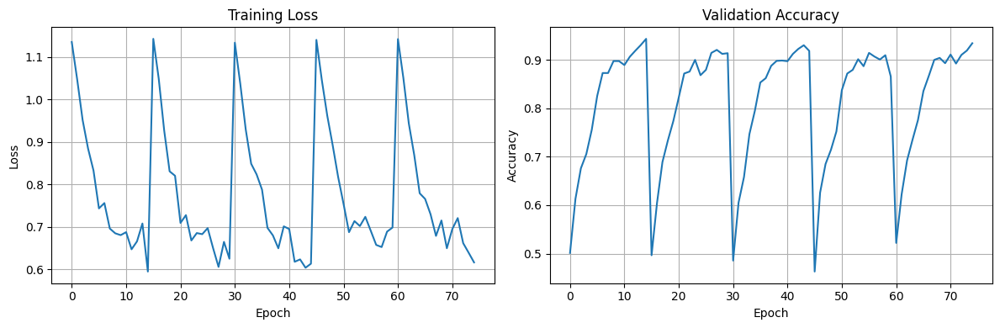


Average Validation Accuracy across all folds: 0.9268


In [ ]:
# Plot training curves and report accuracy
plot_training_curves(all_train_losses, all_val_accuracies)
mean_val_accuracy = sum(fold_accuracies) / len(fold_accuracies)
print(f"\nAverage Validation Accuracy across all folds: {mean_val_accuracy:.4f}")